# **Sutton Trust Music & Science Workshop**

Instructor: Huw Cheston, PhD researcher @ Centre for Music & Science, University of Cambridge

![ST](https://summerschools.suttontrust.com/wp-content/themes/sutton-trust-summer-programme/assets/img/summer_school_logo.png)

© Huw Cheston 2023, hwc31@cam.ac.uk

# Source separation using neural networks

![NN](https://source-separation.github.io/tutorial/_images/source_separation_io.png)

Imagine if we could pull apart the different components of a song and listen to the individual parts of a whole recording. Source separation allows us to do just that. Using neural networks and other machine learning algorithms, we can sift through a recording and tease apart elements like vocals and instruments from background noise. These algorithms work because they are trained on large numbers of existing multi-track recordings, enabling them to discern individual instruments when encountering new material. This technology holds the key to revolutionizing how we remix, remaster, and reimagine audio content; it's no wonder that many of the algorithms developed by music science researchers are often used in leading audio platforms such as iZotope RX and ProTools.

In this workbook, we'll going to use a source separation algorithm called [Spleeter](https://github.com/deezer/spleeter), which was developed by [Deezer](https://www.deezer.com/en/), a music streaming service similar to Spotify. We'll be working with tracks ripped directly from YouTube, so you won't need to download anything beforehand. You also don't need to have any experience of programming to use this workbook, and all the various options will be explained as you go.


## Setup

**Before you do anything else**, hit the *Play* button below, next to the **Show code** line. You may need to move your mouse for this to appear. Please let me know if you get any errors when running this! This may take a minute or so to run, and you'll see some code in the window as this happens: you'll need to wait until the wheel stops spinning and is replaced by a green tick before moving on.

In [1]:
# @title
!apt install ffmpeg
!pip install spleeter yt-dlp

from spleeter.separator import Separator
from IPython.display import Audio, display
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

SAMPLE_RATE = 44100
HOP_LENGTH = 512
MODEL = "spleeter:4stems"

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 16 not upgraded.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.4/49.4 kB 451.4 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.3/77.3 kB 2.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.8/511.8 MB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.6/193.6 kB 18.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 71.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 kB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 67.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57

## Run the model

First things first, go to [YouTube](https://youtube.com) and choose a recording you want to work with. We're looking for recordings that contain **the following instruments**:

*   Vocals;
*   Bass;
*   Drums

You can have any other combination of instruments alongside this, but try and choose a track that contains at least these three.

Aside from this, there are no restrictions on genre here, so choose whatever you think might lead to some interesting results! Once you've found a track, copy the link into the field *yt_link* below. It should look something like https://www.youtube.com/watch?v=NlZ0e5FqZEU

If the track takes a while to start (maybe it has a long intro), you can use the starting_position slider to skip ahead in the track. So, if the music starts at 10 seconds into the video, you'd set the slider to 10.

Once you've set all the parameters, hit the big "Play" icon as before and wait a minute for the recording to process.

In [2]:
yt_link = 'https://www.youtube.com/watch?v=Vh7oIP-QSHs' # @param {type:"string"}
starting_position = 80 # @param {type:"slider", min:1, max:100, step:1}
!yt-dlp -f "bestaudio" --extract-audio --force-overwrites --audio-format mp3 -o youtube.mp3 --postprocessor-args "-ar 44100" $yt_link
full_mix, _ = librosa.load(
    'youtube.mp3',
    sr=SAMPLE_RATE,
    mono=False,
    offset=starting_position,
    duration=60,
    dtype=np.float64
)
print('Instantiating Spleeter model ...')
separator = Separator(MODEL)
print('Separating audio ...')
prediction = separator.separate(full_mix.T)
print('... done !')
for item, wav in prediction.items():
  print(f'↓↓↓ Listen to {item.title()} below ↓↓↓')
  display(Audio(wav.mean(axis=1), rate=SAMPLE_RATE))

[youtube] Extracting URL: https://www.youtube.com/watch?v=Vh7oIP-QSHs
[youtube] Vh7oIP-QSHs: Downloading webpage
[youtube] Vh7oIP-QSHs: Downloading ios player API JSON
[youtube] Vh7oIP-QSHs: Downloading android player API JSON
[youtube] Vh7oIP-QSHs: Downloading m3u8 information
[info] Vh7oIP-QSHs: Downloading 1 format(s): 251
[download] Destination: youtube.webm
[download] 100% of    2.86MiB in 00:00:00 at 10.49MiB/s
[ExtractAudio] Destination: youtube.mp3
Deleting original file youtube.webm (pass -k to keep)
Instantiating Spleeter model ...
Separating audio ...
INFO:spleeter:Downloading model archive https://github.com/deezer/spleeter/releases/download/v1.4.0/4stems.tar.gz


INFO:spleeter:Downloading model archive https://github.com/deezer/spleeter/releases/download/v1.4.0/4stems.tar.gz


INFO:spleeter:Validating archive checksum


INFO:spleeter:Validating archive checksum


INFO:spleeter:Extracting downloaded 4stems archive


INFO:spleeter:Extracting downloaded 4stems archive


INFO:spleeter:4stems model file(s) extracted


INFO:spleeter:4stems model file(s) extracted
Instructions for updating:
Use output_signature instead
Instructions for updating:
Use output_signature instead
Instructions for updating:
Colocations handled automatically by placer.


... done !
↓↓↓ Listen to Vocals below ↓↓↓


↓↓↓ Listen to Drums below ↓↓↓


↓↓↓ Listen to Bass below ↓↓↓


↓↓↓ Listen to Other below ↓↓↓


## Create a graph

Once you're happy with how the beat tracking is working, you can press the play button on the next cell to create a graph showing waveforms of the original audio file from YouTube,

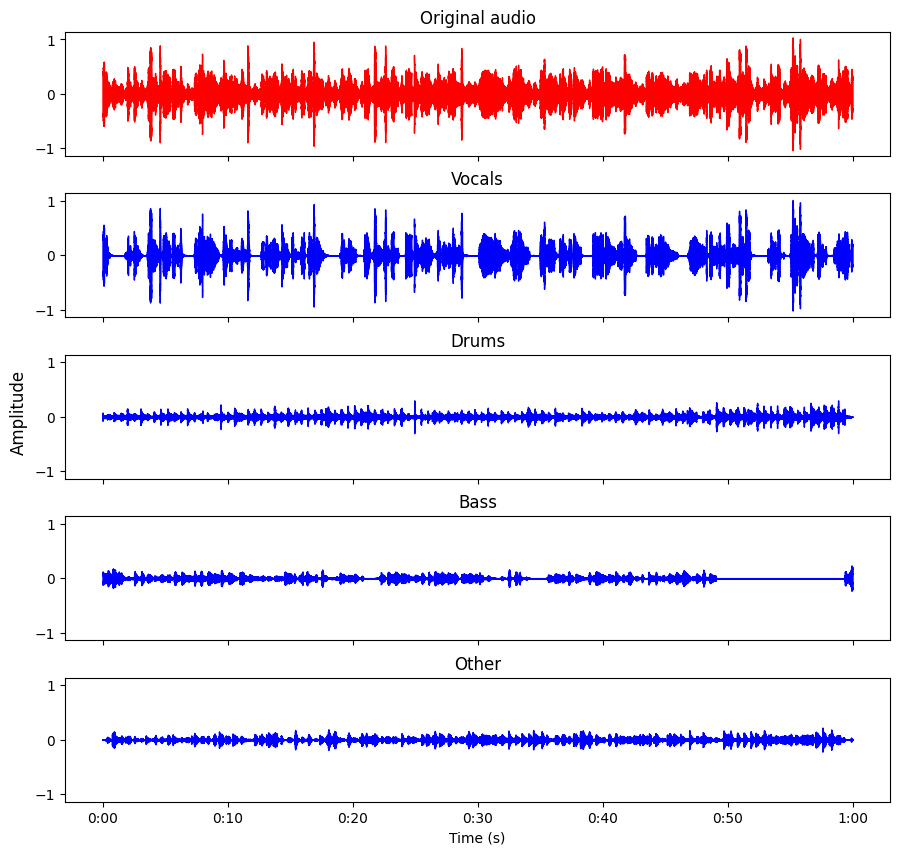

In [4]:
# @title
fig, ax = plt.subplots(nrows=5, sharex=True, sharey=True, figsize=(10, 10))
librosa.display.waveshow(full_mix.mean(axis=0), sr=SAMPLE_RATE, alpha=1, ax=ax[0], color='red')
ax[0].set(title='Original audio', xlabel='')
for (tit, wave), a in zip(prediction.items(), ax[1:].flatten()):
  librosa.display.waveshow(wave.mean(axis=1), sr=SAMPLE_RATE, alpha=1, ax=a, color='blue')
  a.set(title=tit.title(), xlabel='' if tit != 'other' else 'Time (s)')
fig.subplots_adjust(hspace=0.3, left=0.075)
fig.supylabel('Amplitude')
plt.show()

## Evaluate the output

Congratulations, you just used a neural network for the first time! How do the results sound? You can try different combinations of parameters (or different videos) by changing the parameters above and pressing the "Play" button once again.

If you can't think of which tracks to use, you can try the following:

*   Hip-Hop: https://www.youtube.com/watch?v=h69FSgua80A
*   Psychedelic: https://www.youtube.com/watch?v=oc50wHexbwg
*   Rock: https://www.youtube.com/watch?v=de1bt5dc2t0
*   Jazz: https://www.youtube.com/watch?v=Vh7oIP-QSHs

## Discussion questions

1.   Which instruments separate the best? Which instruments separate the worst? Why do you think this is?
2.   Are the results consistent across different genres? What about different songs?
3.   What could we do to improve our results?
4.   What are some of the potential applications of this technology, both in research and in practice?



